<div class="alert alert-block alert-success">

# **1.** Environment Setup

<div>

## 1.1 Import Libraries

In [1]:
base_path = "../"

In [2]:
import pandas as pd
import zipfile
import pickle
from sklearn.preprocessing import LabelEncoder
from pathlib import Path
from sklearn.model_selection import train_test_split
from tensorflow import keras
from keras import regularizers
from classes import *
from functions import *

/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import tensorflow as tf
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Concatenate, Dropout, Input, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau
from keras.metrics import AUC, F1Score, CategoricalAccuracy, TopKCategoricalAccuracy
from sklearn.metrics import f1_score, precision_score, recall_score
from keras import optimizers

In [4]:
#Load the DataFrames from the .pkl files
with open(os.path.join(base_path,"data/train_df.pkl"), "rb") as f:
     train_df = pickle.load(f)

with open(os.path.join(base_path,"data/val_df.pkl"), "rb") as f:
     val_df = pickle.load(f)

with open(os.path.join(base_path,"data/test_df.pkl"), "rb") as f:
     test_df = pickle.load(f)

with open(os.path.join(base_path,"data/train_df_sampled.pkl"), "rb") as f:
     train_df_sampled = pickle.load(f)

with open(os.path.join(base_path,"data/family_encoder.pkl"), "rb") as f:
     family_encoder = pickle.load(f)

In [5]:
class_names = family_encoder.classes_

class_names

array(['accipitridae', 'acipenseridae', 'acroporidae', 'agamidae',
       'agariciidae', 'albulidae', 'alcedinidae', 'alligatoridae',
       'alopiidae', 'ambystomatidae', 'anatidae', 'anguidae', 'aotidae',
       'apidae', 'ardeidae', 'arthroleptidae', 'atelidae', 'attelabidae',
       'balaenicipitidae', 'balaenidae', 'balaenopteridae', 'balistidae',
       'bombycillidae', 'bovidae', 'brachypteraciidae', 'bucerotidae',
       'bufonidae', 'burhinidae', 'cacatuidae', 'callitrichidae',
       'callorhinchidae', 'caprimulgidae', 'carabidae', 'carcharhinidae',
       'cardiidae', 'carettochelyidae', 'cebidae', 'cerambycidae',
       'cercopithecidae', 'cervidae', 'cetorhinidae', 'chaetodontidae',
       'chamaeleonidae', 'charadriidae', 'cheirogaleidae', 'chelidae',
       'cheloniidae', 'chelydridae', 'ciconiidae', 'coenagrionidae',
       'colubridae', 'columbidae', 'conidae', 'cracidae', 'cricetidae',
       'crocodylidae', 'cryptobranchidae', 'ctenomyidae', 'cuculidae',
       'cypr

<div class="alert alert-block alert-success">

# **2.** Preprocessing

<div>

In [6]:
minority_class = train_df['family'].value_counts()[train_df['family'].value_counts() < 25].index
minority_class=minority_class.to_list()

In [7]:
batch_size = 32 ## the less the better because in each epoch the model sees N / batch_size images
image_size = (224, 224)

preprocess = Preprocessor(image_size=image_size, batch_size=batch_size)

2025-04-29 20:33:57.475993: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3
2025-04-29 20:33:57.476017: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-04-29 20:33:57.476021: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-04-29 20:33:57.476163: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-04-29 20:33:57.476172: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


<div class="alert alert-block alert-success">

# **3.** Outliers

<div>

In [8]:
# Load model keras\
model = load_model(os.path.join(base_path,"project/efficient_net_finetuned_final.keras"))

/Users/brunasimoes/Desktop/nova_ims/2_semester/Trimestral/deep_learning/deep-learning-project/.venv/lib/python3.11/site-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 34 variables whereas the saved optimizer has 6 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [9]:
# load datasets with efficientnets preprocessing
train_ds, _ = preprocess.load_img(
    data_dir=os.path.join(base_path,"data/rare_species/train"),
    minority_class=minority_class,
    augment="mixup",
    oversampling=False,
    shuffle= True,
    preprocessing_function=preprocess_input)

Found 8388 files belonging to 202 classes.


### Visualize no confidence images

In [10]:
# Create a list of all images and labels
train_images = []
train_labels = []

for batch in train_ds:
    images_batch, labels_batch = batch
    train_images.append(images_batch.numpy())
    train_labels.append(labels_batch.numpy())

# Stack properly
train_images = np.vstack(train_images)
train_labels = np.vstack(train_labels)

print(train_images.shape)
print(train_labels.shape)

2025-04-29 20:34:26.326714: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


(8388, 224, 224, 3)
(8388, 202)


In [11]:
# Predict all train images
pred_probs_all = model.predict(train_ds, verbose=1)
y_pred = np.argmax(pred_probs_all, axis=1)
y_true = train_labels

2025-04-29 20:34:42.634403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


263/263 ━━━━━━━━━━━━━━━━━━━━ 63s 231ms/step


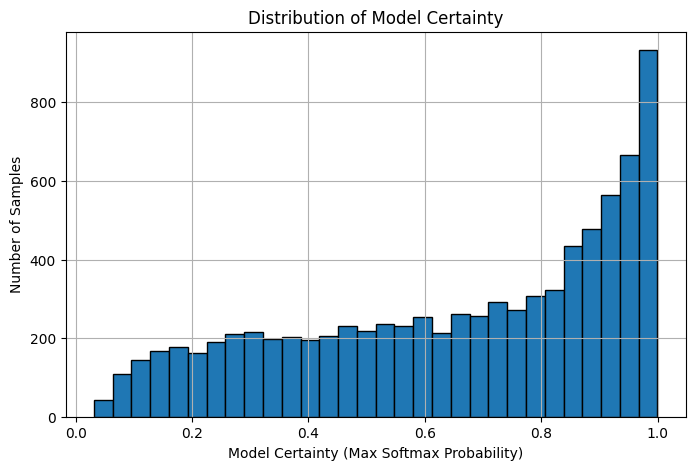

In [12]:
# Plot histogram of certainties
plt.figure(figsize=(8, 5))
plt.hist(np.max(pred_probs_all, axis=1), bins=30, edgecolor='black')
plt.xlabel('Model Certainty (Max Softmax Probability)')
plt.ylabel('Number of Samples')
plt.title('Distribution of Model Certainty')
plt.grid(True)
plt.show()

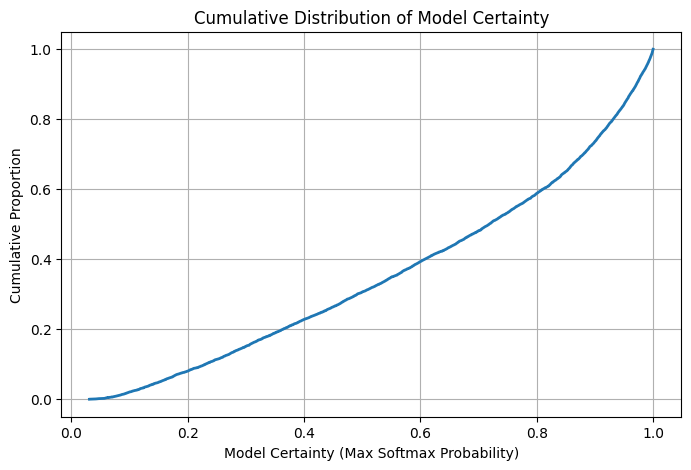

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Get sorted certainties
sorted_certainties = np.sort(np.max(pred_probs_all, axis=1))
cumulative = np.linspace(0, 1, len(sorted_certainties))

# Plot cumulative curve
plt.figure(figsize=(8, 5))
plt.plot(sorted_certainties, cumulative, linewidth=2)
plt.xlabel('Model Certainty (Max Softmax Probability)')
plt.ylabel('Cumulative Proportion')
plt.title('Cumulative Distribution of Model Certainty')
plt.grid(True)
plt.show()


Since you have 202 classes, a model that is completely uncertain (i.e., guessing randomly) would have maximum softmax probability 0.004. But models aren't truly random even when uncertain — usually, even bad predictions are around 0.02–0.1 certainty (depends on how the softmax behaves).

In [16]:
# First, compute the maximum probability for ALL predictions
# Convert y_true to class labels
y_true_labels = np.argmax(y_true, axis=1)

misclassified_indices = np.where(y_true_labels != y_pred)[0]

all_confidences = np.max(pred_probs_all[misclassified_indices], axis=1)  # Shape: (num_train_samples,)

# Total number of train images
total_train_images = len(train_images)

# Number of predictions where certainty < 0.1
num_uncertain_predictions = np.sum(all_confidences < 0.1)

print(f"Total train images: {total_train_images}")
print(f"Number of predictions with certainty < 0.1: {num_uncertain_predictions}")
print(f"Percentage: {100 * num_uncertain_predictions / total_train_images:.2f}%")

Total train images: 8388
Number of predictions with certainty < 0.1: 125
Percentage: 1.49%


In [15]:
well_classified_indices = np.where(y_true_labels == y_pred)[0]

all_confidences = np.max(pred_probs_all[well_classified_indices], axis=1)  # Shape: (num_train_samples,)

# Total number of train images
total_train_images = len(train_images)

# Number of predictions where certainty < 0.15
num_uncertain_predictions = np.sum(all_confidences < 0.15)

print(f"Total train images: {total_train_images}")
print(f"Number of predictions with certainty < 0.15: {num_uncertain_predictions}")
print(f"Percentage: {100 * num_uncertain_predictions / total_train_images:.2f}%")

Total train images: 8388
Number of predictions with certainty < 0.15: 141
Percentage: 1.68%


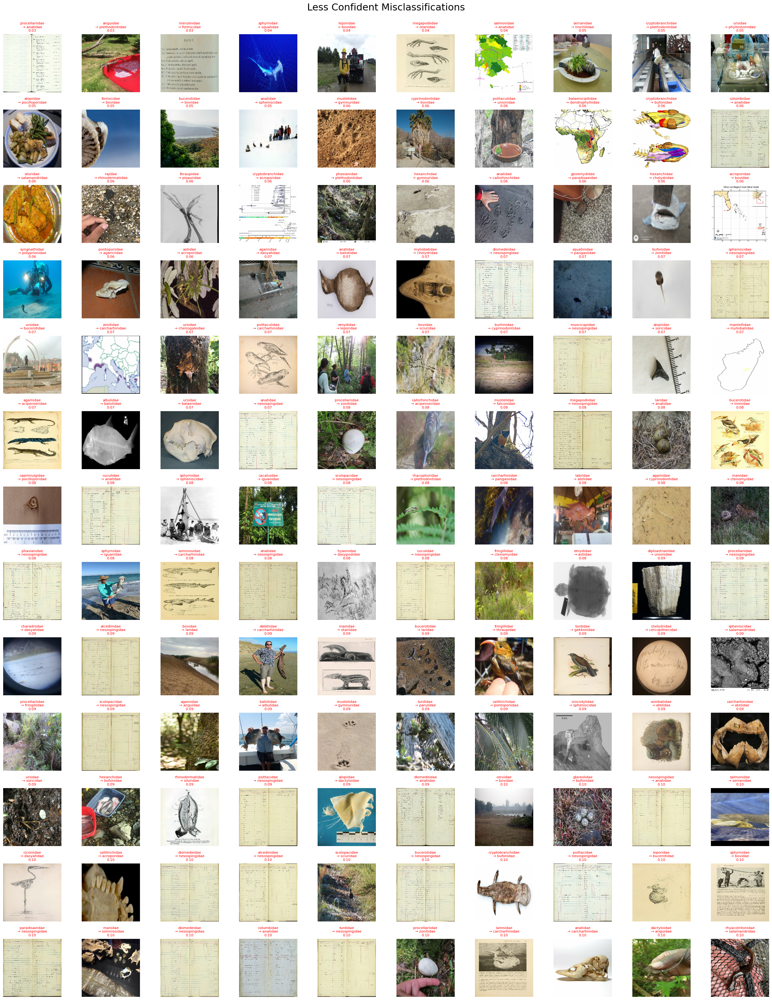

In [31]:
# For each misclassified, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[misclassified_indices], axis=1)

# Sort misclassified examples by descending confidence
sorted_indices = np.argsort(confidences)  # Sort ascending

# Setup grid size
n_rows, n_cols = 13, 10
num_images = n_rows * n_cols

# Adjust selected indices
selected_indices = misclassified_indices[sorted_indices[:num_images]]

# Prepare images to show
images_to_show = []

for idx in selected_indices:
    img = train_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(misclassified_indices == idx)][0]
    images_to_show.append((img, true_label, pred_label, confidence))

# Plot
plt.figure(figsize=(n_cols * 2.5, n_rows * 2.5))  # Large enough to see images clearly

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"{class_names[true_label]}\n→ {class_names[pred_label]}\n{confidence:.2f}",
              color='red', fontsize=8)


plt.suptitle("Less Confident Misclassifications", fontsize=22, y=0.97)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

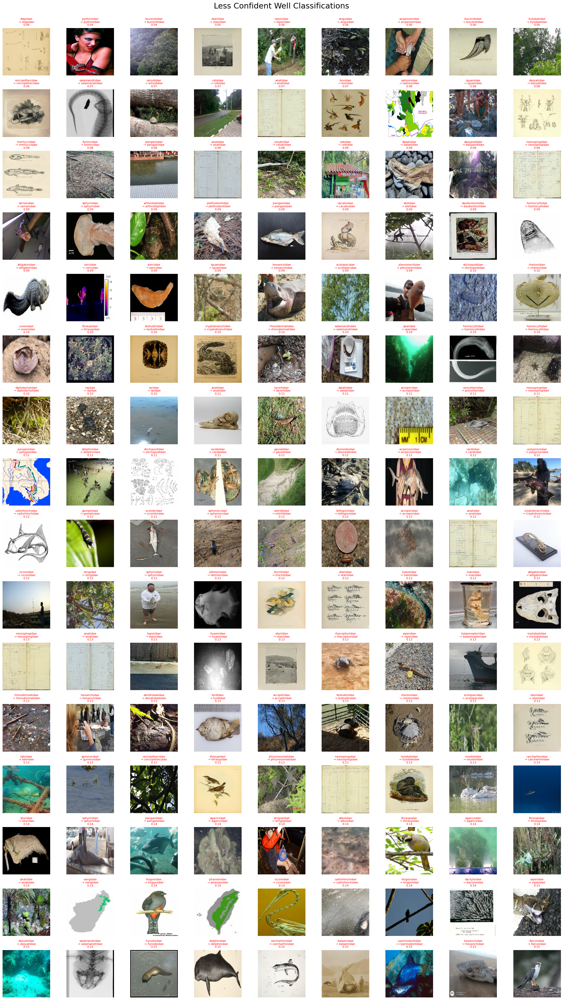

In [ ]:
# For each well_classified, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[well_classified_indices], axis=1)

# Sort well_classified examples by descending confidence
sorted_indices = np.argsort(confidences)  # Sort ascending

# Setup grid size
n_rows, n_cols = 16, 9
num_images = n_rows * n_cols

# Adjust selected indices
selected_indices = well_classified_indices[sorted_indices[:num_images]]

# Prepare images to show
images_to_show = []

for idx in selected_indices:
    img = train_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(well_classified_indices == idx)][0]
    images_to_show.append((img, true_label, pred_label, confidence))

# Plot
plt.figure(figsize=(n_cols * 2.5, n_rows * 2.5))  # Large enough to see images clearly

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"{class_names[true_label]}\n→ {class_names[pred_label]}\n{confidence:.2f}",
              color='red', fontsize=8)

plt.suptitle("Less Confident Well Classifications", fontsize=22, y=0.97)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

In [ ]:
# Keep only confident predictions (confidence ≥ 0.15)
confident_mask = all_confidences >= 0.15

# Filter images and labels
confident_images = train_images[confident_mask]
confident_labels = train_labels[confident_mask]

In [ ]:
confident_ds = tf.data.Dataset.from_tensor_slices((confident_images, confident_labels))
confident_ds = confident_ds.batch(batch_size).prefetch(tf.data.AUTOTUNE)